# scNT-seq

This tutorial uses data from [Qiu, Hu, et al (2020)](https://www.nature.com/articles/s41592-020-0935-4). Special thanks also go to [Hao](https://twitter.com/hao_wu_7) for the tutorial improvement.

In this [study](https://www.nature.com/articles/s41592-020-0935-4), by integrating metabolic RNA labeling, droplet microfluidics (Drop-seq) and chemical conversion of 4sU to cytosine analogs with [TimeLapse](https://www.nature.com/articles/nmeth.4582) chemistry, we developed scNT-seq to jointly profile newly-transcribed (marked by T-to-C substitutions) and pre-existing mRNAs from the same cell at scale. scNT-seq was used to distinguish new from old mRNAs using neuronal activity-induced genes in primary mouse cortical neurons. By linking cis-regulatory sequences to new transcripts, scNT-seq reveals time-resolved TF activity at single-cell levels.

We analyzed the scNT-seq with **Dynamo** to obtain time-resolved metabolic labeling based RNA velocity (computed from new and total RNA levels) which outperforms splicing RNA velocity (due to sparsity of intronic reads for many activity-induced genes) on inferring cell state trajectory during initial neuronal activation (0-30 min). Since dynamo explicitly models the labeling process and considers real time, the velocity learned is intrinsically physical meaningful (with the unit of **molecules / hour**). 

Using pulse-chase labeling and scNT-seq, we further determined rates of RNA biogenesis and decay to uncover RNA regulatory strategies during stepwise conversion between pluripotent and rare totipotent two-cell embryo (2C)-like stem cell states.

Finally, we demonstrated that the library complexity can be substantially improved with 2nd strand synthesis reaction. This allows scNT-seq to detect ~6k genes and ~20k transcripts at ~50k reads per cell. We hope that this approach will be useful to many of you out there.

In this tutorial, we will use the newest dynamo to reanalyze the data and highlight a few analysis that is enabled with our vector field reconstruction algorithm. Please note that we recommend the reader to first go through our [zerafish](https://dynamo-release.readthedocs.io/en/latest/zebrafish.html) tutorial before diving into this tutorial. 

In [ ]:
# get the latest pypi version
# to get the latest version on github and other installations approaches, see:
# https://dynamo-release.readthedocs.io/en/latest/ten_minutes_to_dynamo.html#how-to-install
!pip install dynamo-release --upgrade --quiet

In [1]:
import warnings
warnings.filterwarnings('ignore')

import dynamo as dyn

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 

dyn.get_all_dependencies_version()

package,dynamo-release,umap-learn,anndata,cvxopt,hdbscan,loompy,matplotlib,numba,numpy,pandas,pynndescent,python-igraph,scikit-learn,scipy,seaborn,setuptools,statsmodels,tqdm,trimap,numdifftools,colorcet
version,0.95.2,0.4.6,0.7.4,1.2.3,0.8.26,3.0.6,3.3.0,0.51.0,1.19.1,1.1.1,0.4.8,0.8.2,0.23.2,1.5.2,0.9.0,49.6.0,0.11.1,4.48.2,1.0.12,0.9.39,2.0.2


# Load splicing and labeling data
We prefiltered good quality cells for the labeling data. The same set of high quality cells will also be used to subset the splicing data. We especially focus on cells from `excitatory neurons` which has the strongest response to the KCL treatment. 

In [3]:
neuron_labeling = dyn.read_h5ad('/Users/xqiu/Dropbox/Projects/dynamo-tutorials/data/scNT_seq.h5ad') # Neu\
neuron_splicing = dyn.read_h5ad('/Users/xqiu/Dropbox (Personal)/dynamo/dont_remove/neuron_splicing_4_11.h5ad') # Neu\


In [4]:
print(neuron_labeling)
print(neuron_splicing)

AnnData object with n_obs × n_vars = 3060 × 37007
    obs: 'nGene', 'nUMI', 'time', 'cluster'
    var: 'gene_short_name'
    obsm: 'X_umap_ori'
    layers: 'new', 'total'
AnnData object with n_obs × n_vars = 13476 × 44021
    obs: 'cellname'
    var: 'gene_short_name'
    layers: 'spliced', 'unspliced'


# Subset datasets with neural activity genes

Note that this labeling experiment is a mixture labeling experiment (See more discussion [here](https://dynamo-release.readthedocs.io/en/latest/Introduction.html#Labeling-strategies)). In this experiment, the cells are all labeled for 2 hours (so we set `label_time` as `2`) but `Kcl` was added at different time point prior to cell harvest. Therefore the neural cells will start from the steady state, followed by a activation stage characterized by the KCL-induced depolarization (except the 120 minutes time point).

Since the neural activation dynamics is intricate and happens on the scale of 0-30 minutes, we need to focus our analysis on the subset of neural activity genes (identified in `Fig SI2d`). Note that this operation is specific for this system and generally not required for systems operate on a longer time scale. 

In [5]:
neuron_labeling.obs['label_time'] = 2 # this is the labeling time 
tkey = 'label_time'

neuron_labeling = neuron_labeling[cell_filter.A1, :]

peng_gene_list = pd.read_csv('/Users/xqiu/Dropbox (Personal)/dynamo/dont_remove/0408_grp_info.txt', sep='\t')

neuron_labeling = neuron_labeling[:, peng_gene_list.index]



Let us also subset the splicing data with the same set of cells and genes from the labeling data.

In [6]:
neuron_splicing = neuron_splicing[neuron_labeling.obs_names, neuron_labeling.var_names]
neuron_labeling.obs['time'] = neuron_labeling.obs.time.astype('category')
neuron_splicing.obs = neuron_labeling.obs.copy()


Trying to set attribute `.obs` of view, copying.


# Run a typical dynamo analysis
This analysis consists the following five steps: 
    
    1. the preprocessing:
    2. kinetic estimation and velocity calculation;
    3. dimension reduction 
    4. high dimension velocity projection
    5. vector field reconstruction 
    
Note that dynamo is smart enough to automatically detect your data type (splicing or labeling data) and choose the proper estimation method to analyze your data. The kinetic estimation and velocity calculation framework in dynamo is extremely sophisticated and comprehensive. See [here](https://dynamo-release.readthedocs.io/en/latest/Introduction.html#Dynamo's-comprehensive-model-framework-for-lableing-datasets) for an overall. Full details will be described in our final publication. 

Note that setting `calc_rnd_vel=True` in `dyn.tl.cell_velocities` will enable us to calculate randomized velocity which provides confidently support for the specificity of the observed time-resolved RNA velocity flow. 

In [7]:
def dynamo_workflow(adata):
    adata = dyn.pp.recipe_monocle(adata)

    dyn.tl.dynamics(adata)

    dyn.tl.reduceDimension(adata)

    dyn.tl.cell_velocities(adata, calc_rnd_vel=True)
    
    dyn.vf.VectorField(adata, basis='umap')
    

In [8]:
%%capture 

dynamo_workflow(neuron_splicing)
dynamo_workflow(neuron_labeling)


## Time resolved dynamo velocity outperforms splicing velocity

UMAP visualization of excitatory neurons (n = 3,060 cells, >2,000 genes detected per cell) that were characterized by standard splicing kinetics-based (left) or metabolic labeling-based (right) RNA velocity analyses. Cells are color coded by time points. The streamlines indicate the integration paths that connect local projections from the observed state to the extrapolated future state. The lower UMAP plots (same as upper) show randomized velocity controls for splicing kinetics- or metabolic labeling-based RNA velocity. The streamline thickness indicates the magnitude of the velocity. 

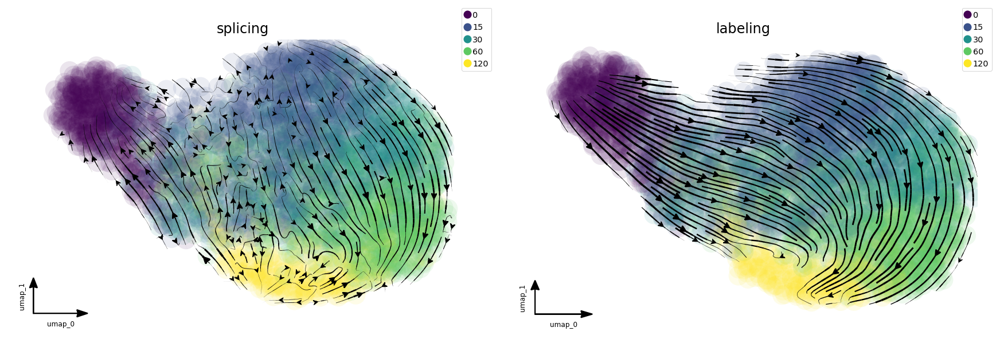

In [9]:
fig1, f1_axes = plt.subplots(ncols=2, nrows=1, constrained_layout=True, figsize=(12, 4))
f1_axes[0] = dyn.pl.streamline_plot(neuron_splicing, color='time', color_key_cmap = 'viridis', basis='umap', ax=f1_axes[0], show_legend='right', save_show_or_return='return')
f1_axes[0].set_title('splicing')
f1_axes[1] = dyn.pl.streamline_plot(neuron_labeling, color='time', color_key_cmap = 'viridis', basis='umap', ax=f1_axes[1], show_legend='right', save_show_or_return='return')
f1_axes[1].set_title('labeling')
plt.show()


From the randomized velocity controls shown below for splicing kinetics or metabolic labeling-based RNA velocity, we can conclude our observed time-resolved RNA velocity is highly specific and confident. 

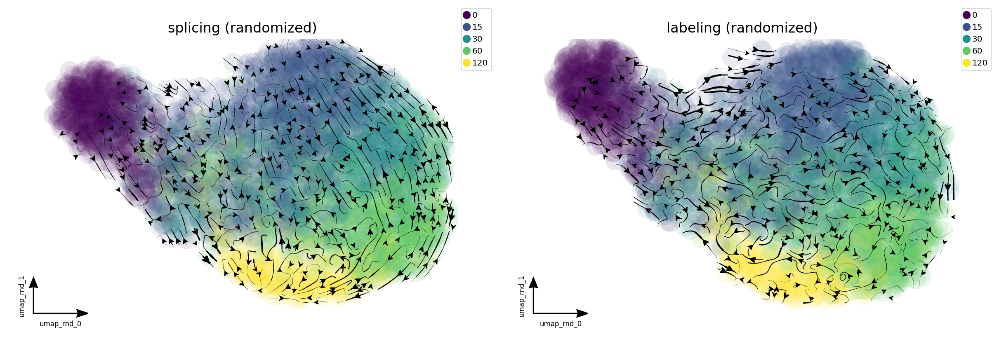

In [10]:
fig1, f1_axes = plt.subplots(ncols=2, nrows=1, constrained_layout=True, figsize=(12, 4))
f1_axes[0] = dyn.pl.streamline_plot(neuron_splicing, color='time', color_key_cmap = 'viridis', basis='umap_rnd', ax=f1_axes[0], show_legend='right', save_show_or_return='return')
f1_axes[0].set_title('splicing (randomized)')
f1_axes[1] = dyn.pl.streamline_plot(neuron_labeling, color='time', color_key_cmap = 'viridis', basis='umap_rnd', ax=f1_axes[1], show_legend='right', save_show_or_return='return')
f1_axes[1].set_title('labeling (randomized)')
plt.show()

## Calculate the cell-wise velocity confidence metric

There are many different methods to estimate the cell-wise velocity confidence. By default it uses jaccard index, which measures how well each velocity vector meets the geometric constraints defined by the local neighborhood structure. Jaccard index is calculated as the fraction of the number of the intersected set of nearest neighbors from each cell at current expression state (X) and that from the future expression state (X + V) over the number of the union of these two sets. The cosine or correlation method is similar to that used by [scVelo](https://github.com/theislab/scvelo).

calculating correlation based cell wise confidence: 100%|██████████| 3060/3060 [00:30<00:00, 101.18it/s]


<Figure size 600x400 with 0 Axes>

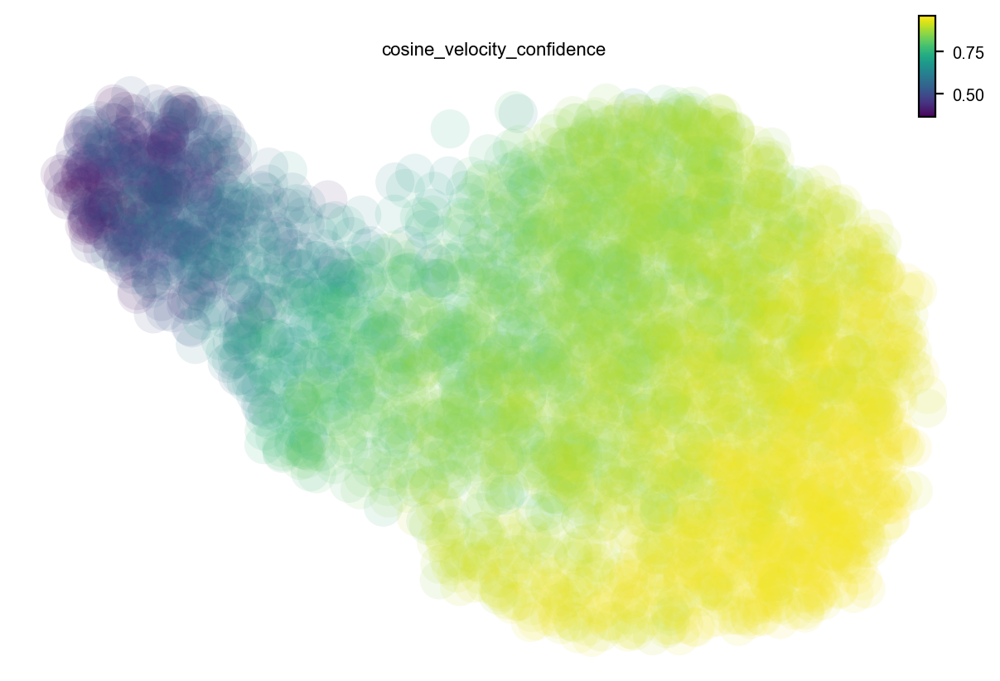

In [31]:
# you can also check the 'jaccord', 'cosine' or other methods
dyn.tl.cell_wise_confidence(neuron_labeling, ekey='M_t', vkey='velocity_T', method='correlation') 
dyn.pl.umap(neuron_labeling, color='cosine_velocity_confidence')


## Why splicing velocity is worse? 

One of the many reasons about why labeling based data is better than RNA velocity is that 4sU will label all nascent RNA in a more uniform fashion while the capture of introns by `mis-priming` in conventional scRNA-seq is highly biased due to sparsity of intronic reads for many  genes (especially those often lowly expressed transcription factors or activity-induced genes as shown here). Here we can see that, except `Homer1`, both `Egr` and `Fos` have very insufficient intron readds, probably resulting from the lack of poly A/T enriched regions in their introns. 

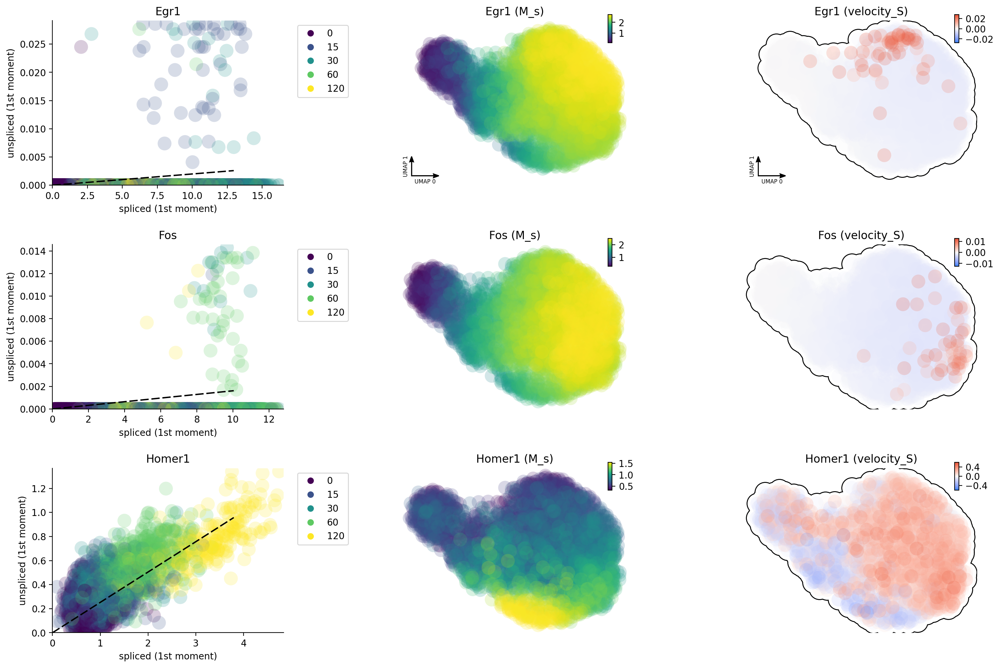

In [11]:
gene_list = ["Egr1", "Fos", "Homer1"]
dyn.pl.phase_portraits(neuron_splicing, genes=gene_list, color='time',  discrete_continous_div_color_key=[None, None, None], discrete_continous_div_color_key_cmap=['viridis', None, None], ncols=6,  pointsize=5)


Unsprising, the labeling data gives us much improved capture of nascent RNA and reveal that Egr1 / Fos are early and immediate neural activation genes, respectively while Homer 1 is a late response gene. This is so cool! 

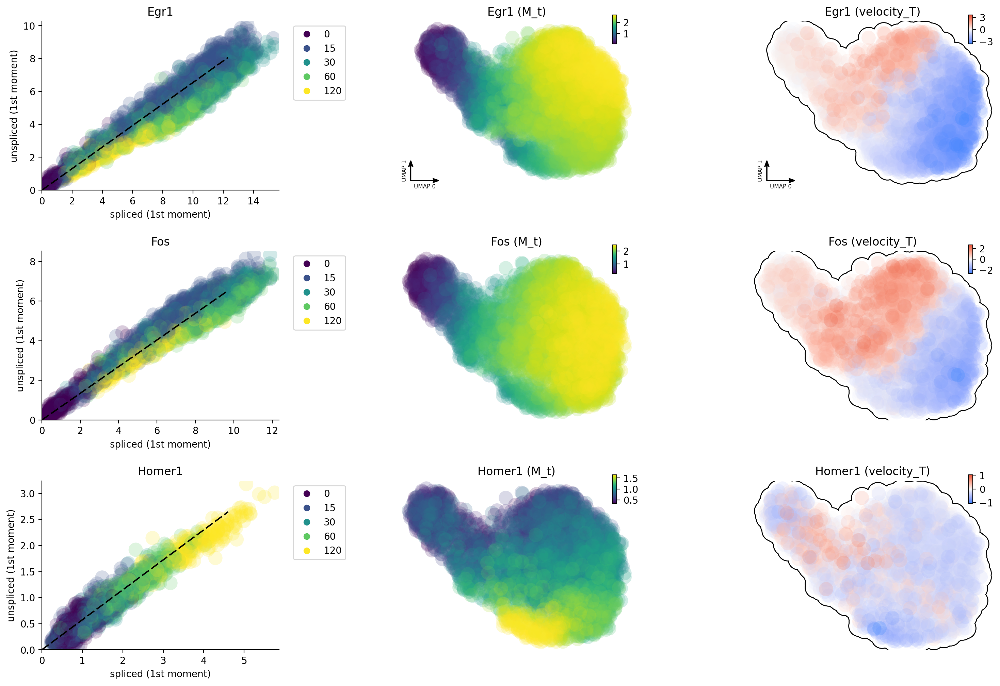

In [12]:
dyn.pl.phase_portraits(neuron_labeling, genes=gene_list, color='time',  discrete_continous_div_color_key=[None, None, None], discrete_continous_div_color_key_cmap=['viridis', None, None], ncols=6,  pointsize=5)


## Animate neural depolarization dynamics

In the following, let us also have some fun with animating neural activity response predictions via reconstructed vector field function

In [19]:
progenitor = neuron_labeling.obs_names[neuron_labeling.obs.time == 0]

In [20]:
np.random.seed(19491001)

from matplotlib import animation
info_genes = neuron_labeling.var_names[neuron_labeling.var.use_for_transition]
dyn.pd.fate(neuron_labeling, basis='umap', init_cells=progenitor, interpolation_num=100,  direction='forward',
   inverse_transform=False, average=False)


uniformly sampling points along a trajectory: 100%|██████████| 445/445 [00:01<00:00, 326.06it/s]


AnnData object with n_obs × n_vars = 3060 × 97
    obs: 'nGene', 'nUMI', 'time', 'cluster', 'label_time', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'total_Size_Factor', 'initial_total_cell_size', 'Size_Factor', 'initial_cell_size', 'new_Size_Factor', 'initial_new_cell_size', 'ntr'
    var: 'gene_short_name', 'pass_basic_filter', 'use_for_pca', 'ntr', 'alpha', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'beta_k', 'gamma_k', 'use_for_dynamics', 'use_for_transition'
    uns: 'pp_norm_method', 'PCs', 'explained_variance_ratio_', 'pca_fit', 'feature_selection', 'dynamics', 'neighbors', 'umap_fit', 'grid_velocity_umap', 'grid_velocity_umap_rnd', 'VecFld_umap', 'VecFld', 'fate_umap'
    obsm: 'X_umap_ori', 'X_pca', 'X', 'X_umap', 'velocity_umap', 'X_umap_rnd', 'velocity_umap_rnd', 'velocity_umap_SparseVFC', 'X_umap_SparseVFC'
    varm: 'alpha'
    layers: 'new', 'total', 

In [21]:
%%capture
fig, ax = plt.subplots()
ax = dyn.pl.topography(neuron_labeling, color='time', ax=ax, save_show_or_return='return', color_key_cmap='viridis', figsize=(24, 24))
ax.set_aspect(0.8)

In [23]:
%%capture
instance = dyn.mv.StreamFuncAnim(adata=neuron_labeling, color='time', ax=ax)

In [24]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128 # Ensure all frames will be embedded.

from matplotlib import animation
import numpy as np

anim = animation.FuncAnimation(instance.fig, instance.update, init_func=instance.init_background,
                               frames=np.arange(100), interval=100, blit=True)
from IPython.core.display import display, HTML
HTML(anim.to_jshtml()) # embedding to jupyter notebook.
